# Name : Surendra Kumar Kumawat
## **Task4 - Exploratory Data Analysis - Terrorism**
Perform ‘Exploratory Data Analysis’ on dataset ‘Global Terrorism’ (https://bit.ly/2TK5Xn5). As a security/defense analyst, try to find out the hot zone of terrorism. 

### Importing the necessary libraries  and data

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

C:\Users\Surendra\Anaconda3\lib\site-packages\statsmodels\tools\_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [2]:
url = 'globalterrorismdb.csv'
df = pd.read_csv(url,encoding='latin1', low_memory=False)
df

,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,...,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
0,197000000001,1970,7,2,NaN,0,NaN,58,Dominican Republic,2,...,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN
1,197000000002,1970,0,0,NaN,0,NaN,130,Mexico,1,...,NaN,NaN,NaN,NaN,PGIS,0,1,1,1,NaN
2,197001000001,1970,1,0,NaN,0,NaN,160,Philippines,5,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
3,197001000002,1970,1,0,NaN,0,NaN,78,Greece,8,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
4,197001000003,1970,1,0,NaN,0,NaN,101,Japan,4,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
181686,201712310022,2017,12,31,NaN,0,NaN,182,Somalia,11,...,NaN,"""Somalia: Al-Shabaab Militants Attack Army Che...","""Highlights: Somalia Daily Media Highlights 2 ...","""Highlights: Somalia Daily Media Highlights 1 ...",START Primary Collection,0,0,0,0,NaN
181687,201712310029,2017,12,31,NaN,0,NaN,200,Syria,10,...,NaN,"""Putin's 'victory' in Syria has turned into a ...","""Two Russian soldiers killed at Hmeymim base i...","""Two Russian servicemen killed in Syria mortar...",START Primary Collection,-9,-9,1,1,NaN
181688,201712310030,2017,12,31,NaN,0,NaN,160,Philippines,5,...,NaN,"""Maguindanao clashes trap tribe members,"" Phil...",NaN,NaN,START Primary Collection,0,0,0,0,NaN
181689,201712310031,2017,12,31,NaN,0,NaN,92,India,6,...,NaN,"""Trader escapes grenade attack in Imphal,"" Bus...",NaN,NaN,START Primary Collection,-9,-9,0,-9,NaN


In [3]:
df.columns.values    #to see all the columns in the dataset

array(['eventid', 'iyear', 'imonth', 'iday', 'approxdate', 'extended',
       'resolution', 'country', 'country_txt', 'region', 'region_txt',
       'provstate', 'city', 'latitude', 'longitude', 'specificity',
       'vicinity', 'location', 'summary', 'crit1', 'crit2', 'crit3',
       'doubtterr', 'alternative', 'alternative_txt', 'multiple',
       'success', 'suicide', 'attacktype1', 'attacktype1_txt',
       'attacktype2', 'attacktype2_txt', 'attacktype3', 'attacktype3_txt',
       'targtype1', 'targtype1_txt', 'targsubtype1', 'targsubtype1_txt',
       'corp1', 'target1', 'natlty1', 'natlty1_txt', 'targtype2',
       'targtype2_txt', 'targsubtype2', 'targsubtype2_txt', 'corp2',
       'target2', 'natlty2', 'natlty2_txt', 'targtype3', 'targtype3_txt',
       'targsubtype3', 'targsubtype3_txt', 'corp3', 'target3', 'natlty3',
       'natlty3_txt', 'gname', 'gsubname', 'gname2', 'gsubname2',
       'gname3', 'gsubname3', 'motive', 'guncertain1', 'guncertain2',
       'guncertain3', 'in

#### Drop all the unnecessary Columns and Rename the columns as follows :

In [4]:
df = df[["iyear", "imonth", "iday","country", "country_txt", "region_txt", "city","success", "attacktype1_txt","nkill", "propvalue", "targtype1_txt","latitude","gname","longitude", "targsubtype1_txt","target1","weaptype1_txt", "weapdetail"]]

In [5]:
df.rename(columns = {'iyear':'Year', "imonth":"Month","iday":"Day", "country":"Country_no",
                     "country_txt":"Country","region_txt":"Region","city":"City", "propvalue":"property_value",
                     "attacktype1_txt":"Attack_type", "targtype1_txt":"Target_type","gname":"group_name",
                     "targsubtype1_txt":"Target_sub_type", "target1":"Target", "nkill":"no_of_kills",
                     "weaptype1_txt":"Weapon_type", "weapdetail":"Weapon_detail"}, inplace = True)

C:\Users\Surendra\Anaconda3\lib\site-packages\pandas\core\frame.py:4449: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


In [6]:
df.columns

Index(['Year', 'Month', 'Day', 'Country_no', 'Country', 'Region', 'City',
       'success', 'Attack_type', 'no_of_kills', 'property_value',
       'Target_type', 'latitude', 'group_name', 'longitude', 'Target_sub_type',
       'Target', 'Weapon_type', 'Weapon_detail'],
      dtype='object')

In [7]:
df.isnull().sum()

Year                    0
Month                   0
Day                     0
Country_no              0
Country                 0
Region                  0
City                  434
success                 0
Attack_type             0
no_of_kills         10313
property_value     142702
Target_type             0
latitude             4556
group_name              0
longitude            4557
Target_sub_type     10373
Target                636
Weapon_type             0
Weapon_detail       67670
dtype: int64

### Treatmenting the null values

In [8]:
df["City"].fillna("Unknown", inplace = True)
df["Target"].fillna("Unknown", inplace = True)
df["property_value"].fillna(0, inplace = True)
df["no_of_kills"].fillna(0, inplace = True)

C:\Users\Surendra\Anaconda3\lib\site-packages\pandas\core\series.py:4469: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  downcast=downcast,


In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 181691 entries, 0 to 181690
Data columns (total 19 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   Year             181691 non-null  int64  
 1   Month            181691 non-null  int64  
 2   Day              181691 non-null  int64  
 3   Country_no       181691 non-null  int64  
 4   Country          181691 non-null  object 
 5   Region           181691 non-null  object 
 6   City             181691 non-null  object 
 7   success          181691 non-null  int64  
 8   Attack_type      181691 non-null  object 
 9   no_of_kills      181691 non-null  float64
 10  property_value   181691 non-null  float64
 11  Target_type      181691 non-null  object 
 12  latitude         177135 non-null  float64
 13  group_name       181691 non-null  object 
 14  longitude        177134 non-null  float64
 15  Target_sub_type  171318 non-null  object 
 16  Target           181691 non-null  obje

In [10]:
df.head()

,Year,Month,Day,Country_no,Country,Region,City,success,Attack_type,no_of_kills,property_value,Target_type,latitude,group_name,longitude,Target_sub_type,Target,Weapon_type,Weapon_detail
0,1970,7,2,58,Dominican Republic,Central America & Caribbean,Santo Domingo,1,Assassination,1.0,0.0,Private Citizens & Property,18.456792,MANO-D,-69.951164,Named Civilian,Julio Guzman,Unknown,NaN
1,1970,0,0,130,Mexico,North America,Mexico city,1,Hostage Taking (Kidnapping),0.0,0.0,Government (Diplomatic),19.371887,23rd of September Communist League,-99.086624,"Diplomatic Personnel (outside of embassy, cons...","Nadine Chaval, daughter",Unknown,NaN
2,1970,1,0,160,Philippines,Southeast Asia,Unknown,1,Assassination,1.0,0.0,Journalists & Media,15.478598,Unknown,120.599741,Radio Journalist/Staff/Facility,Employee,Unknown,NaN
3,1970,1,0,78,Greece,Western Europe,Athens,1,Bombing/Explosion,0.0,0.0,Government (Diplomatic),37.997490,Unknown,23.762728,Embassy/Consulate,U.S. Embassy,Explosives,Explosive
4,1970,1,0,101,Japan,East Asia,Fukouka,1,Facility/Infrastructure Attack,0.0,0.0,Government (Diplomatic),33.580412,Unknown,130.396361,Embassy/Consulate,U.S. Consulate,Incendiary,Incendiary


# Visualizing the data

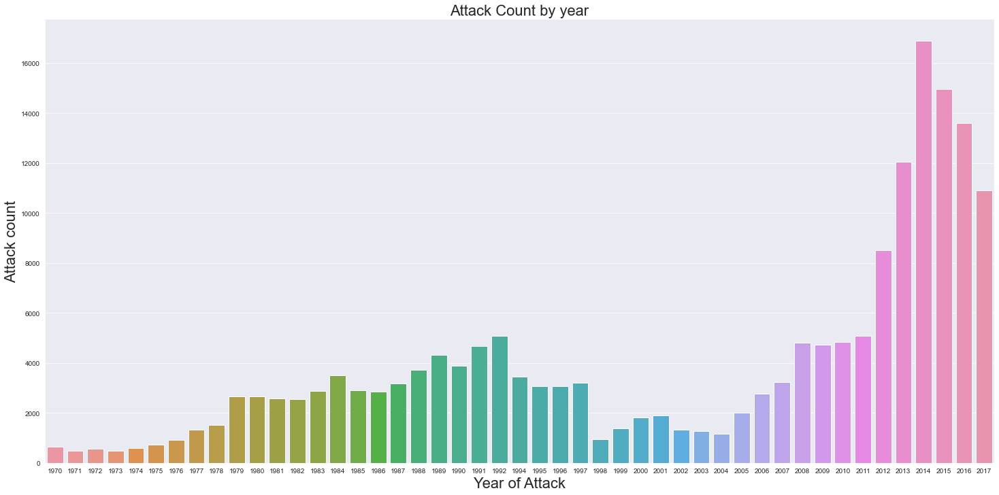

In [11]:
sns.set_style('darkgrid')
plt.figure(figsize=(25,12))
plt.title("Attack Count by year",fontsize=22)
sns.countplot(x ='Year', data = df)  # Using Count Plot...
plt.ylabel("Attack count", fontsize=22)
plt.xlabel("Year of Attack", fontsize=22)
plt.show()

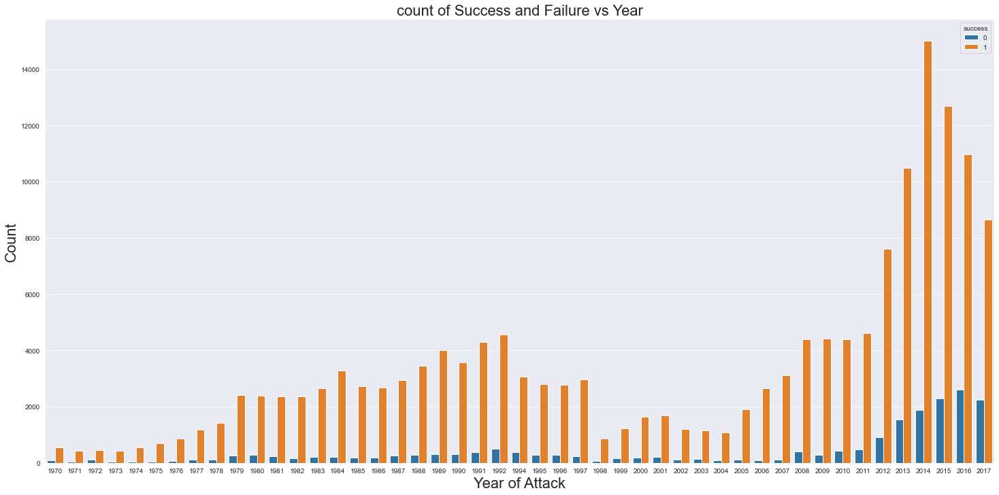

In [12]:
plt.figure(figsize=(25,12))   
plt.title("count of Success and Failure vs Year",fontsize=22)
sns.set_style('darkgrid')
sns.countplot(x ='Year', hue = "success", data = df)
plt.ylabel("Count", fontsize=22)
plt.xlabel("Year of Attack", fontsize=22)
plt.show()

### Visualize the data on world map According to year of attack

In [13]:
dfMap=df.where(df['latitude']!=None).sort_values(by='Year')

dfMap=dfMap.groupby(['Year','latitude','longitude','City','Country']).count()
a=dfMap.index.values
l=list(a)
Alt = [x[1] for x in l]
Long = [y[2] for y in l]
Years= [a[0] for a in l]
Countries= [c[-1] for c in l]
Cities = [c[-2] for c in l]
#print(Cities)
Alt = np.array(Alt)
Long = np.array(Long)
Years = np.array(Years)
Countries = np.array(Countries)
Cities=np.array(Cities)

In [14]:
fig = px.scatter_geo(dfMap, lon=Long,lat=Alt ,#color=Countries,
                     hover_name=Cities, 
                     animation_frame=Years,
                     projection="equirectangular",
                    labels={"eventid": "Attacks",'animation_frame':'Year'})
fig.update_layout(title='Map of terrorism attacks in the world between : 1970 & 2017')
fig.show()

### Top countries who suffered the most by terror attack

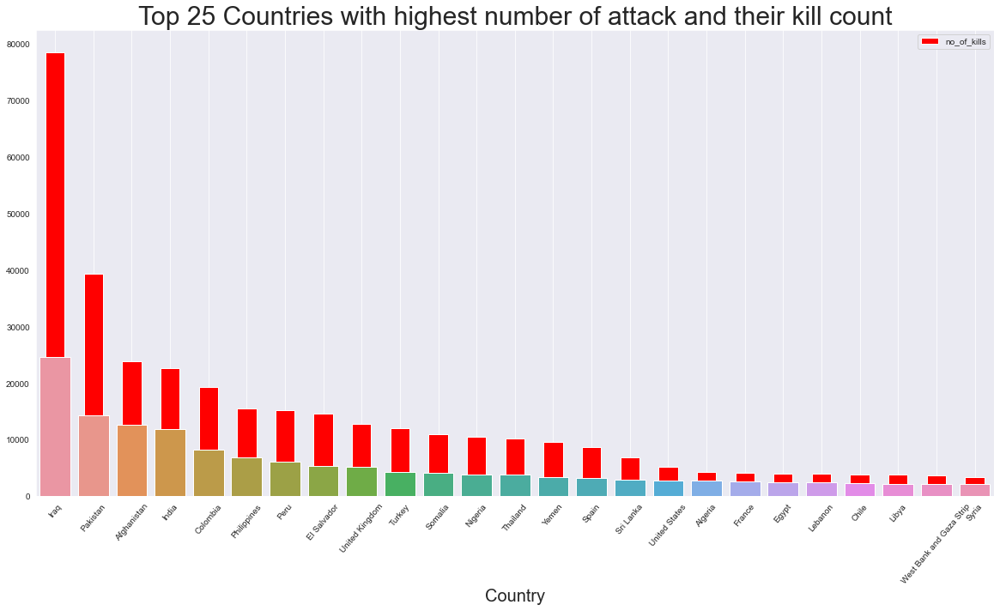

In [15]:
#df['country_txt'].value_counts()
plt.figure(figsize = (20,10))
df.groupby(['Country'])['no_of_kills'].sum().sort_values(ascending=False)[:25].plot(kind='bar',color='red')

sns.barplot(x=df['Country'].value_counts()[:25].index,y=df['Country'].value_counts()[:25].values)
plt.xticks(rotation = 50)
plt.xlabel('Country',fontsize=20)
#plt.ylabel('Number of Attacks',fontsize=20)
plt.title('Top 25 Countries with highest number of attack and their kill count',fontsize=30)
plt.legend()
plt.grid()
plt.show()


In [16]:
# #df['City'].value_counts()
# plt.figure(figsize=(20,10))
# sns.barplot(x=df['City'].value_counts()[:25].index,y=df['City'].value_counts()[:25])
# plt.xticks(rotation =90)
# plt.xlabel("Cities",fontsize=15)
# # plt.ylabel("Number of Attack",size=15)
# plt.title("Top 25 Cities Suffered by Terror attack",fontsize=25)
# plt.show()

In [17]:
# plt.figure(figsize=(25,12))   
# df.groupby(['City'])['no_of_kills'].sum().sort_values(ascending=False)[:25].plot(kind='bar')
# plt.title('Number of kills by city',fontsize=22)
# plt.xlabel('cities',fontsize=22)
# plt.xticks(rotation = 50)
# plt.ylabel('Kill count',fontsize=22)


###  Top cities in the world who suffered most by terror attack

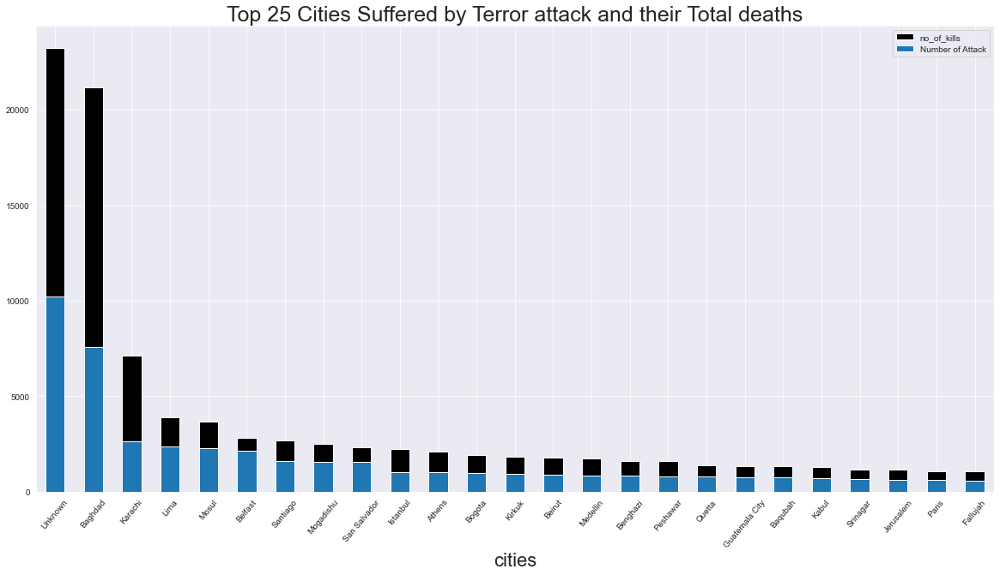

In [18]:
plt.figure(figsize=(20,10))
df.groupby(['City'])['no_of_kills'].sum().sort_values(ascending=False)[:25].plot(kind='bar',color='black')
df['City'].value_counts().sort_values(ascending=False)[:25].plot(kind='bar')
l=plt.legend()
l.get_texts()[1].set_text("Number of Attack")
plt.xlabel('cities',fontsize=22)
plt.xticks(rotation = 50)
plt.title("Top 25 Cities Suffered by Terror attack and their Total deaths",fontsize=25)
plt.show()

# Visualize the data Only for year 2011-2017 (Recent years)
To get the information about current Hotspots

In [19]:
df1 = df[df['Year']>2010]

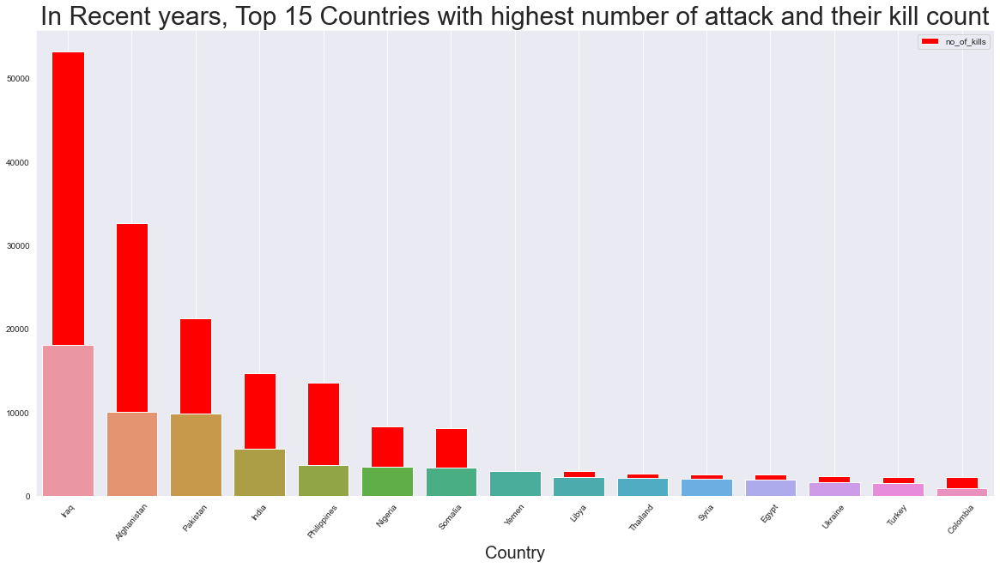

In [20]:
#df['country_txt'].value_counts()
plt.figure(figsize = (20,10))
df1.groupby(['Country'])['no_of_kills'].sum().sort_values(ascending=False)[:15].plot(kind='bar',color='red')

sns.barplot(x=df1['Country'].value_counts()[:15].index,y=df1['Country'].value_counts()[:15].values)
plt.xticks(rotation = 50)
plt.xlabel('Country',fontsize=20)
#plt.ylabel('Number of Attacks',fontsize=20)
plt.title('In Recent years, Top 15 Countries with highest number of attack and their kill count',fontsize=30)
plt.legend()
plt.grid()
plt.show()


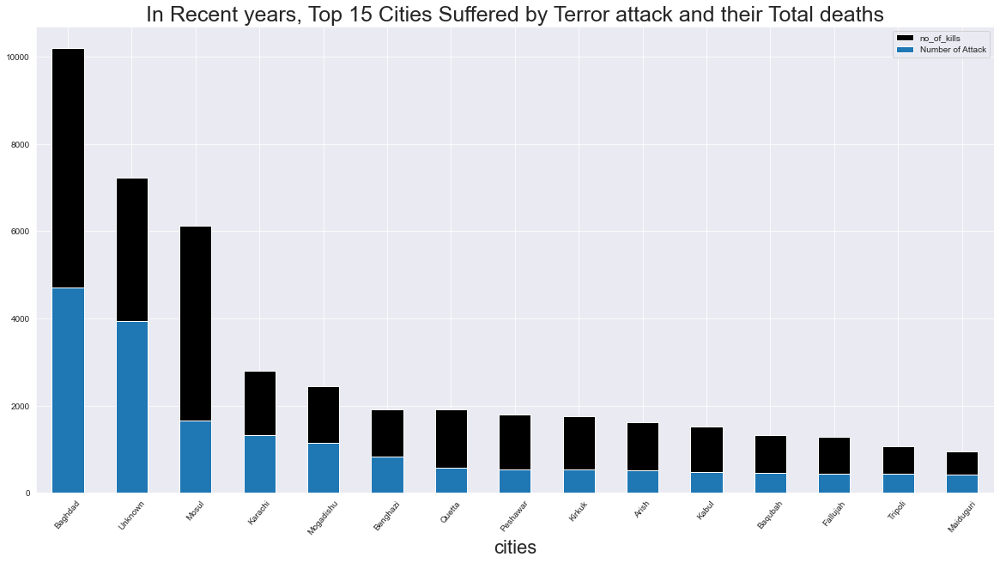

In [21]:
plt.figure(figsize=(20,10))
df1.groupby(['City'])['no_of_kills'].sum().sort_values(ascending=False)[:15].plot(kind='bar',color='black')
df1['City'].value_counts().sort_values(ascending=False)[:15].plot(kind='bar')
l=plt.legend()
l.get_texts()[1].set_text("Number of Attack")
plt.xlabel('cities',fontsize=22)
plt.xticks(rotation = 50)
plt.title("In Recent years, Top 15 Cities Suffered by Terror attack and their Total deaths",fontsize=25)
plt.show()

## Visualization of Type of terror attack and the percentage of people killed in different types of attack

In [22]:
px.pie(df, values='no_of_kills', names='Attack_type', title='Type of attack and kill percentage') 

## Visualization of Type of Weapon used in terror attack and ratio of people killed in different types of Weapon

In [23]:
px.pie(df, values='no_of_kills', names='Weapon_type', title='Type of Weapon and kill percentage')

## Visualization of Target of terror attack and the ratio of people killed in different types of attack

In [24]:
px.pie(df, values='no_of_kills', names='Target_type', title="Type of target and it's kill percentage")

# Conlusion :
## 1) There is a sudden increase in terror activities after year-2011
## 2) Top contries who faced the most number of attacks
(i) Iraq  (ii) Pakistan  (iii) Afghanistan  (iv) India  (v) Colombia
   ## In Recent years, Top contries who faced the most number of attacks
   (i) Iraq  (ii) Afghanistan  (iii) Pakistan  (iv) India  (v) Philippines
## 3) Top cities who faced the most number of attacks
(i) Baghdad  (ii) Karachi (iii) Lima  (iv) Mosul  (v) Belfast
## In Recent years, Top cities who faced the most number of attacks
(i) Baghdad  (ii) Mosul  (iii) Karachi  (iv) Mogadishu  (v) Benghazi
## 4) Tpyes of attack in which people killed the most
(i) Armed Assault  (ii) Bombing/Explosion  (iii) Assasination  (iv) Hostage Taking(Kidnapping)
## 5) Top Weapons with people kiled the most
(i) Firearms  (ii) Explosives (iii) Melee
## 6) Top target of terrorist where most number of people killed
(i) Private Citizens & proprty  (ii) Military  (iii) Police  (iv) Government(general) (v) Business  (vi) Transportation